# **Drone Detection System**

## Importing Libraries

- Imported essential libraries such as `TensorFlow`, `Keras`, and `scikit-learn` for building, training, and evaluating the machine learning model.
- Imported `OpenCV` and `PIL` for image processing tasks.
- Used `matplotlib` and `seaborn` for data visualization and plotting.

### Setup Environment:

- `%matplotlib inline` is used to display plots inline in  Notebook.
- Suppressed warnings using `warnings.filterwarnings('ignore')` to keep the output clean.

In [9]:
from sklearn.model_selection import train_test_split

from tensorflow import keras
import tensorflow as tf
from tensorflow.keras import layers
from tensorflow.keras.layers import Dense,Flatten
from tensorflow.keras import Model,Input

import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns

import warnings
warnings.filterwarnings('ignore')

import cv2
from PIL import Image


## Loading and pre-processing the data

### Load and Preprocess Images:

- Used `glob` to find all `.jpg `images in the specified directory and loaded them using `PIL`.
- Converted images to RGB format and resized them to 256x256 pixels for consistent input size.

### Extract Annotations:

- Parsed corresponding annotation files (`.txt`)` for each image to extract bounding box coordinates.
- Stored the coordinates in a list `train_annotation` for later use in model training.

In [10]:
import glob
from PIL import Image
import numpy as np

train_image = []
train_annotation = []

image_file = glob.glob("D:/Projects/DRONE DETECTION SYSTEM/archive/drone_dataset_yolo/dataset_txt/*.jpg")

for i in image_file:  # slicing for insufficient memory
    Load_image = Image.open(i).convert('RGB')
    nmpy_img = Load_image.resize((256, 256))
    train_image.append(np.asarray(nmpy_img))

    seperate_path = i.split('.')
    seperate_path[1] = 'txt'  # corrected the extension change

    with open(seperate_path[0] + '.' + seperate_path[1]) as f:  # corrected file extension
        lines = f.readlines()
        tmp_lst = lines[0].split(' ')
        startX = float(tmp_lst[1])
        startY = float(tmp_lst[2])
        endX = float(tmp_lst[3])
        endY = float(tmp_lst[4])
        train_annotation.append((startX, startY, endX, endY))


## Displaying sample images

### Visualize Training Images:
- Displayed the first 15 training images in a 5x5 grid using `matplotlib` to verify correct loading and preprocessing.
### Check Data Length:
- Printed the total number of loaded images to confirm the dataset size `(len(train_image))`.

1359


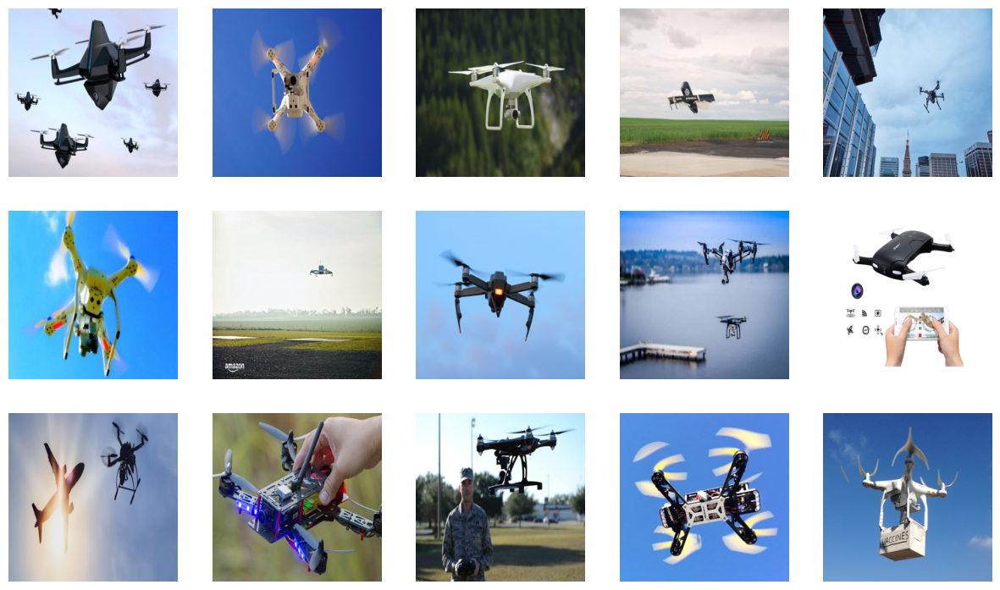

In [11]:
print(len(train_image))

plt.figure(figsize=(15, 15))

for i in range(15):
    ax = plt.subplot(5, 5, i + 1)
    plt.imshow(train_image[i].astype("uint8"))
    plt.axis("off")

## Splitting the data into training and testing sets

### Normalize and Prepare Data:

- Converted image data and annotations to numpy arrays and normalized pixel values to the range [0, 1].
### Split Data into Training and Testing Sets:

- Used `train_test_split` to split the dataset into training (90%) and testing (10%) subsets for model evaluation.
### Check Data Shape:

- Printed the shapes of the data and target arrays to confirm the correct dimensions and successful split.

In [12]:
from sklearn.model_selection import train_test_split
data = np.array(train_image, dtype='float32') / 255.0   # memory not sufficient !!
targets = np.array(train_annotation, dtype='float32')

split = train_test_split(data, targets, test_size=0.10, random_state=42)

(trainImages, testImages) = split[:2]
(trainTargets, testTargets) = split[2:4]

# Printing the shapes of the data and targets arrays

data.shape, targets.shape

((1359, 256, 256, 3), (1359, 4))

# VGG16
- VGG16 is a convolutional neural network architecture known for deep learning tasks.
- It uses `16 layers` to extract features from images, improving classification accuracy.
- Useful for `image recognition`, `object detection`, and `feature extraction`.
- Best for `pre-trained models`, `transfer learning`, and `computer vision` applications.
- Useful in a drone detection system by identifying and localizing drones in images through its `strong feature extraction` and `object recognition capabilities`.


## Building model

- Loaded the pre-trained VGG16 model without the top layers for feature extraction on new input images of size (256, 256, 3).
- Made the VGG16 model trainable, enabling fine-tuning during training.
- Added a custom bounding box head with fully connected layers to predict object boundaries (x, y, width, height).
- The output of the model is a 4-dimensional vector representing bounding box coordinates.


In [10]:
import tensorflow as tf
from tensorflow.keras.layers import Dense, Flatten
from tensorflow.keras import Model, Input

def build_vggmodel():
    vgg = tf.keras.applications.vgg16.VGG16(weights="imagenet", include_top=False, input_tensor=Input(shape=(256, 256, 3)))

    vgg.trainable = True

    flatten = vgg.output
    flatten = Flatten()(flatten)

    bboxHead = Dense(128, activation="relu")(flatten)
    bboxHead = Dense(64, activation="relu")(bboxHead)
    bboxHead = Dense(32, activation="relu")(bboxHead)
    bboxHead = Dense(4, activation="linear")(bboxHead)

    vggmodel = Model(inputs=vgg.input, outputs=bboxHead)
    
    return vggmodel

vggmodel = build_vggmodel()

vggmodel.summary()


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_1 (InputLayer)      │ (None, 256, 256, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_conv1 (Conv2D)           │ (None, 256, 256, 64)   │         1,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_conv2 (Conv2D)           │ (None, 256, 256, 64)   │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_pool (MaxPooling2D)      │ (None, 128, 128, 64)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_conv1 (Conv2D)           │ (None, 128, 128, 128)  │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_conv2 (Conv2D)           │ (None, 128, 128, 128)  │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_pool (MaxPooling2D)      │ (None, 64, 64, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv1 (Conv2D)           │ (None, 64, 64, 256)    │       295,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv2 (Conv2D)           │ (None, 64, 64, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv3 (Conv2D)           │ (None, 64, 64, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_pool (MaxPooling2D)      │ (None, 32, 32, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv1 (Conv2D)           │ (None, 32, 32, 512)    │     1,180,160 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv2 (Conv2D)           │ (None, 32, 32, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv3 (Conv2D)           │ (None, 32, 32, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_pool (MaxPooling2D)      │ (None, 16, 16, 512)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv1 (Conv2D)           │ (None, 16, 16, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv2 (Conv2D)           │ (None, 16, 16, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv3 (Conv2D)           │ (None, 16, 16, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_pool (MaxPooling2D)      │ (None, 8, 8, 512)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_1 (Flatten)             │ (None, 32768)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_4 (Dense)                 │ (None, 128)            │     4,194,432 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_5 (Dense)                 │ (None, 64)             │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_6 (Dense)                 │ (None, 32)             │         2,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_7 (Dense)                 │ (None, 4)              │           132 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 18,919,588 (72.17 MB)

 Trainable params: 18,919,588 (72.17 MB)

 Non-trainable params: 0 (0.00 B)

## Compiling and training the model

- Compiled the model using the Adam optimizer with a learning rate of 0.001 and mean squared error (MSE) as the loss function.
- Set up a callback to save the best model based on validation loss during training.
- Trained the model on image data and bounding box targets with an 80-20 training-validation split over 50 epochs.
- Output includes training and validation loss, accuracy, and the saved best model.


In [12]:
vggmodel.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.001), loss='mse', metrics=['accuracy'])

save_best = tf.keras.callbacks.ModelCheckpoint("VGGModel.keras", monitor='val_loss', save_best_only=True, verbose=1)

historyvgg = vggmodel.fit(
    trainImages,
    trainTargets,
    validation_split=0.2,
    batch_size=16,
    epochs=50,
    verbose=1,
    callbacks=[save_best]
)



Epoch 1/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 8s/step - accuracy: 0.3610 - loss: 0.3714
Epoch 1: val_loss improved from inf to 0.04359, saving model to VGGModel.keras
62/62 ━━━━━━━━━━━━━━━━━━━━ 555s 9s/step - accuracy: 0.3633 - loss: 0.3681 - val_accuracy: 0.1143 - val_loss: 0.0436
Epoch 2/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 8s/step - accuracy: 0.5157 - loss: 0.0382
Epoch 2: val_loss did not improve from 0.04359
62/62 ━━━━━━━━━━━━━━━━━━━━ 532s 9s/step - accuracy: 0.5171 - loss: 0.0382 - val_accuracy: 0.6082 - val_loss: 0.0541
Epoch 3/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 8s/step - accuracy: 0.5902 - loss: 0.0383
Epoch 3: val_loss improved from 0.04359 to 0.03851, saving model to VGGModel.keras
62/62 ━━━━━━━━━━━━━━━━━━━━ 519s 8s/step - accuracy: 0.5906 - loss: 0.0383 - val_accuracy: 0.6082 - val_loss: 0.0385
Epoch 4/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 8s/step - accuracy: 0.6509 - loss: 0.0295
Epoch 4: val_loss did not improve from 0.03851
62/62 ━━━━━━━━━━━━━━━━━━━━ 517s 8s/step - accuracy: 0.6512 - los

## Predictions on test images
- Loaded the pre-trained VGG16 model from the `.keras` file.
- Converted and saved the model to HDF5 format (`.h5`), allowing compatibility with different environments or frameworks.
- Output confirms the new model path after successful conversion.


In [6]:
import tensorflow as tf

# Load the model from the .keras file
model_path_keras = r"D:\Projects\DRONE DETECTION SYSTEM\VGGModel.keras"
vggmodel = tf.keras.models.load_model(model_path_keras)

# Save the model in HDF5 format (.h5) in the desired path
model_path_h5 = r"D:\Projects\DRONE DETECTION SYSTEM\VGGModel.h5"
vggmodel.save(model_path_h5)

print(f"Model has been converted and saved to: {model_path_h5}")


Model has been converted and saved to: D:\Projects\DRONE DETECTION SYSTEM\VGGModel.h5


### Testing and Visualizing Predictions from VGG16 Model

- Loaded the pre-trained VGG16 model from an `.h5` file with a custom loss function (`mse`).
- Preprocessed 10 test images by resizing them to (256, 256) and normalizing pixel values.
- Used the model to predict bounding boxes for these 10 images.
- Visualized each test image along with its predicted bounding box coordinates using `matplotlib`.


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


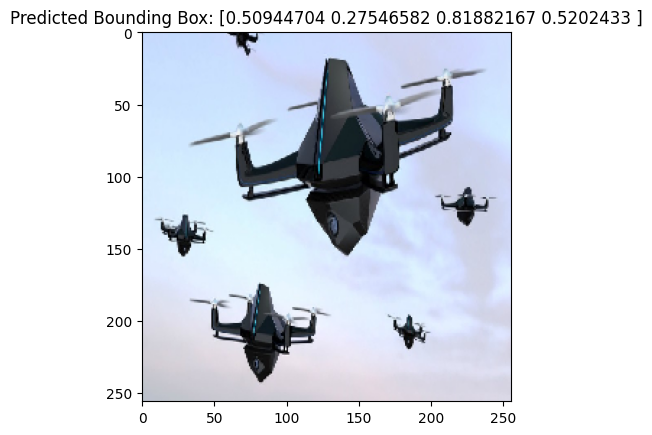

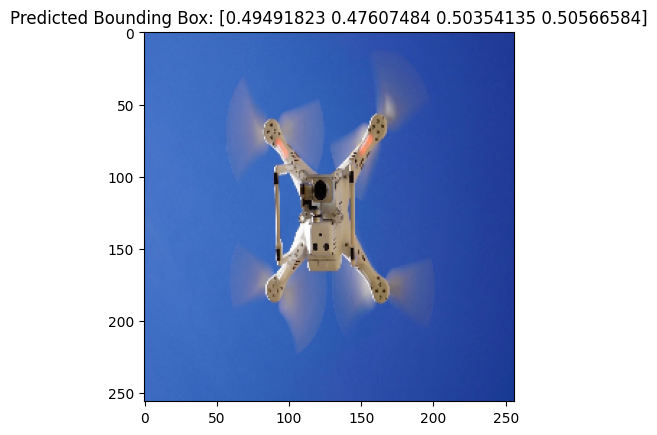

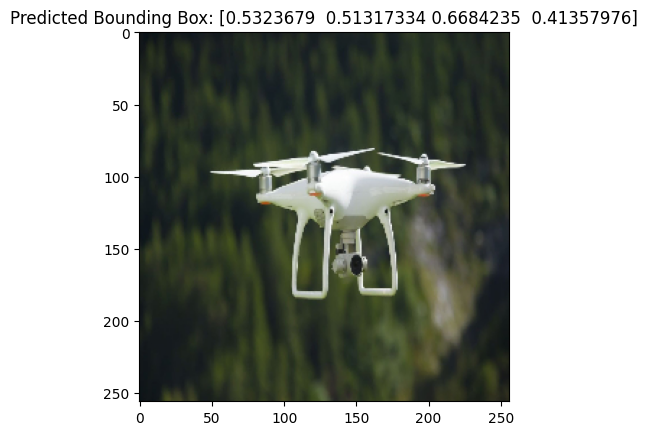

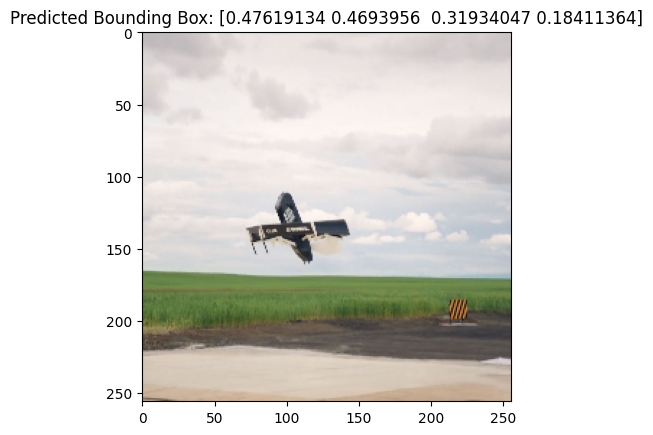

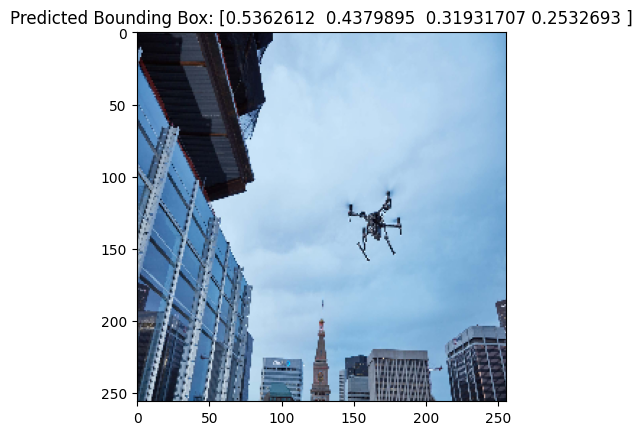

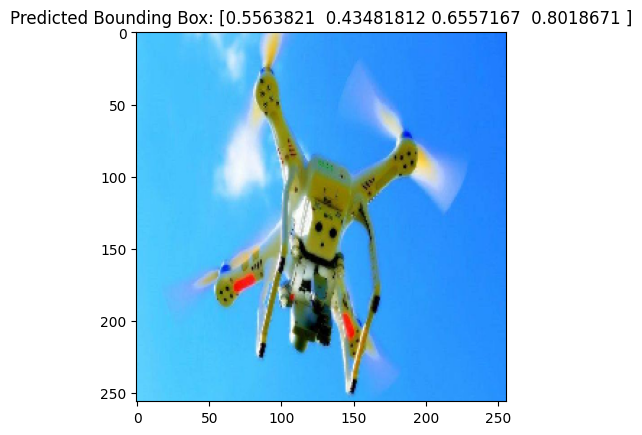

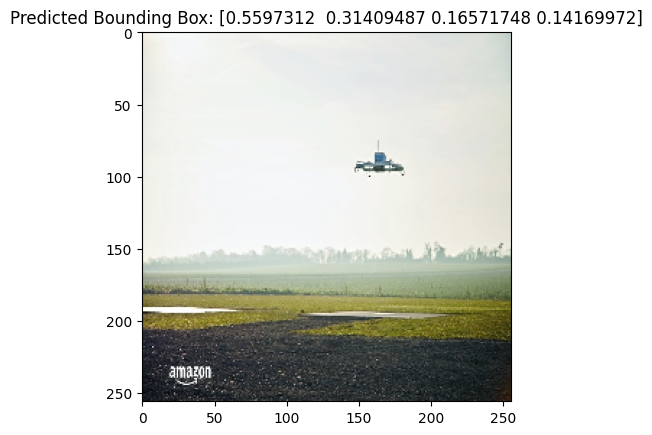

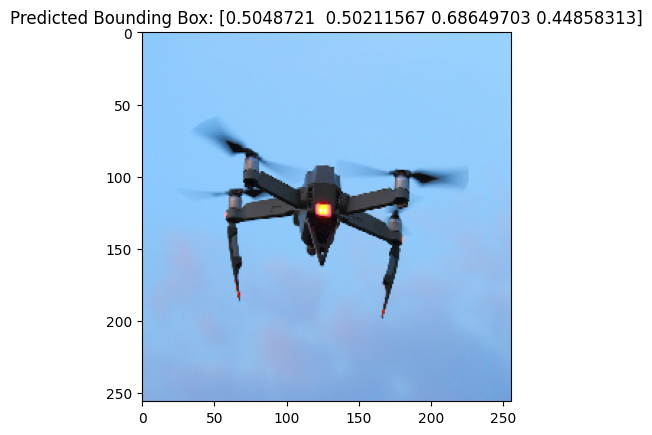

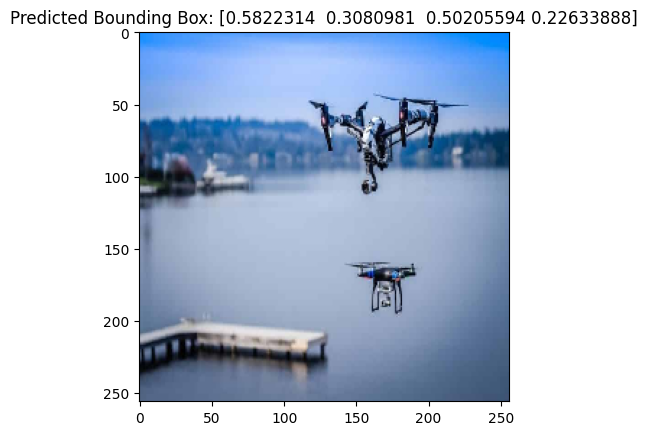

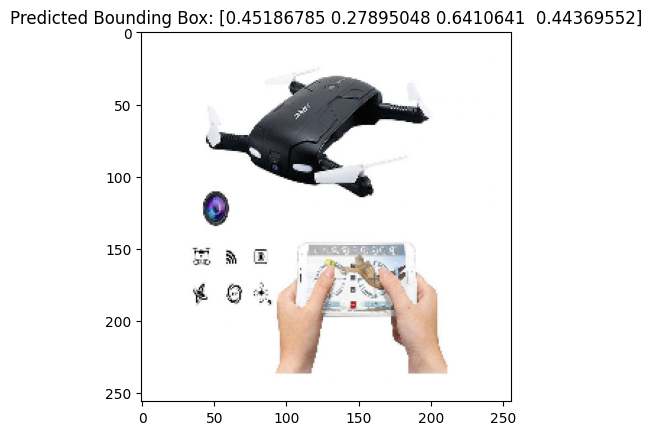

In [9]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing.image import load_img, img_to_array
import glob

# Load the model with custom objects
model_path_h5 = r"D:\Projects\DRONE DETECTION SYSTEM\VGGModel.h5"
vggmodel = tf.keras.models.load_model(model_path_h5, custom_objects={'mse': tf.keras.losses.MeanSquaredError()})

# Path to your test images
image_files = glob.glob(r"D:\Projects\DRONE DETECTION SYSTEM\archive\drone_dataset_yolo\dataset_txt\*.jpg")

# Load and preprocess 10 images
testImages = []
for file in image_files[:10]:  # Load only the first 10 images
    img = load_img(file, target_size=(256, 256))  # Load the image and resize to (256, 256)
    img_array = img_to_array(img) / 255.0  # Convert to array and normalize
    testImages.append(img_array)

testImages = np.array(testImages)  # Convert list to numpy array

# Make predictions on the 10 test images
predictions = vggmodel.predict(testImages, verbose=1)

# Display results: visualize the 10 test images with their predicted bounding boxes
for i, file in enumerate(image_files[:10]):
    plt.figure()
    plt.imshow(testImages[i])
    plt.title(f"Predicted Bounding Box: {predictions[i]}")  # Show the predicted results
    plt.show()


### Loading, Preprocessing, and Visualizing AI Genrated Test Images

- Generated images using AI and saved them in a folder to evaluate model accuracy.
- Loaded the VGG16 model from an `.h5` file with a custom loss function (`mse`).
- Preprocessed test images by resizing them to (256, 256), normalizing, and filtering out images with incorrect dimensions.
- Added error handling for missing or improperly shaped images, ensuring robust preprocessing.
- Made predictions on valid test images and visualized them with predicted bounding boxes.


Loaded image D:\Projects\DRONE DETECTION SYSTEM\test photos\test_image_1.jpeg with shape: (256, 256, 3)
Loaded image D:\Projects\DRONE DETECTION SYSTEM\test photos\test_image_2.jpeg with shape: (256, 256, 3)
Loaded image D:\Projects\DRONE DETECTION SYSTEM\test photos\test_image_3.jpeg with shape: (256, 256, 3)
Loaded image D:\Projects\DRONE DETECTION SYSTEM\test photos\test_image_4.jpeg with shape: (256, 256, 3)
Loaded image D:\Projects\DRONE DETECTION SYSTEM\test photos\test_image_5.jpeg with shape: (256, 256, 3)
Loaded image D:\Projects\DRONE DETECTION SYSTEM\test photos\test_image_6.jpeg with shape: (256, 256, 3)
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


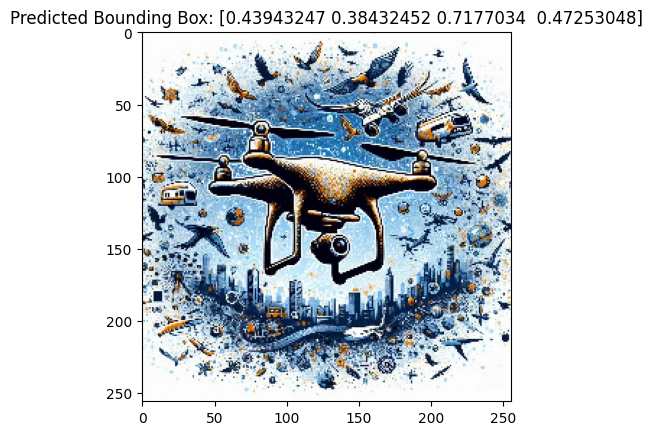

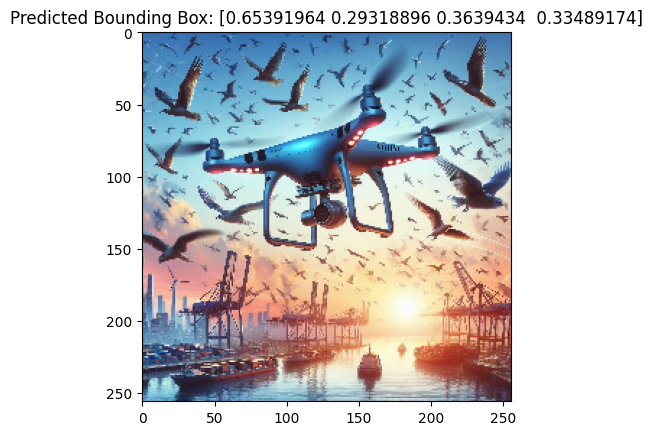

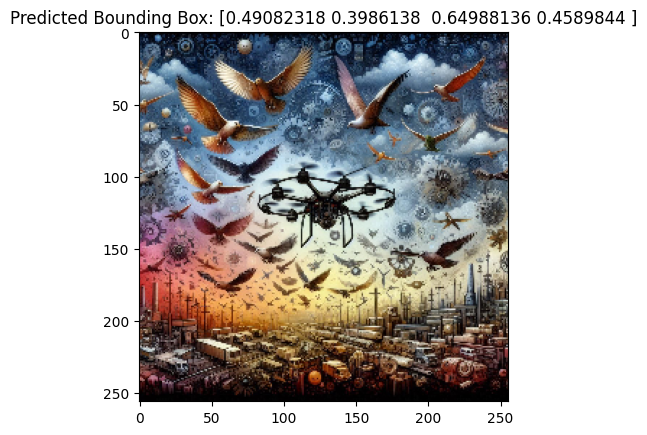

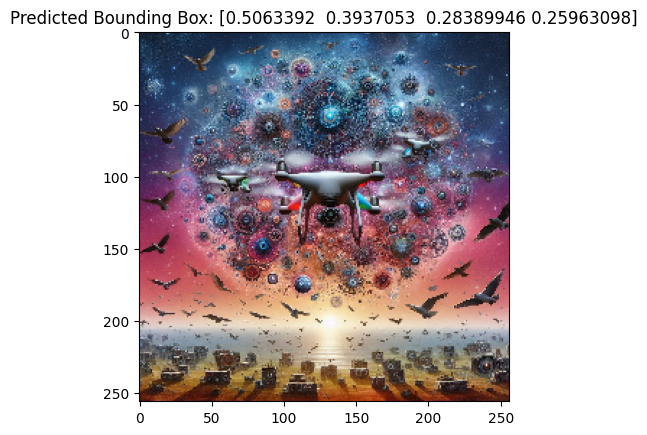

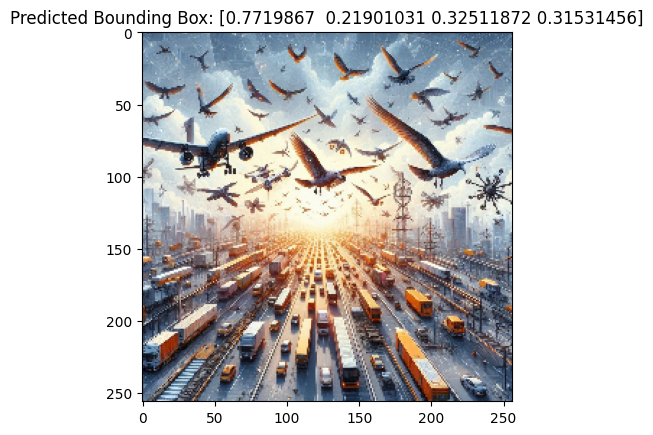

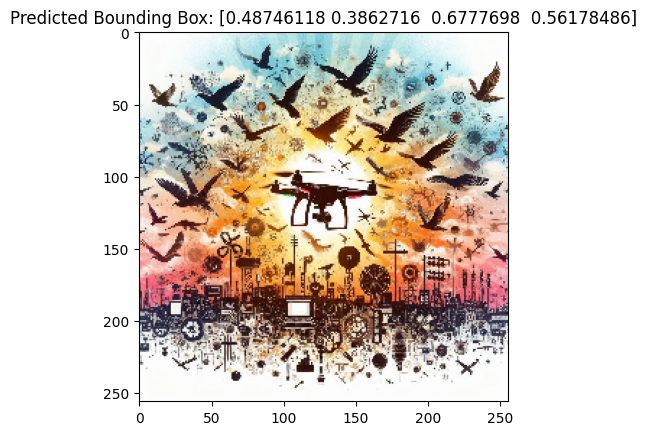

In [15]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing.image import load_img, img_to_array
import glob
import os

# Load the model with custom objects
model_path_h5 = r"D:\Projects\DRONE DETECTION SYSTEM\VGGModel.h5"
vggmodel = tf.keras.models.load_model(model_path_h5, custom_objects={'mse': tf.keras.losses.MeanSquaredError()})

# Path to your test images folder
test_images_path = r"D:\Projects\DRONE DETECTION SYSTEM\test photos\*.jpeg"  # Updated to look for .jpeg files

# Load and preprocess the test images
test_images_files = glob.glob(test_images_path)
testImages = []

# Check if any files were found
if not test_images_files:
    raise ValueError("No .jpeg image files found in the specified directory.")

for file in test_images_files:
    try:
        # Load and resize the image
        img = load_img(file, target_size=(256, 256))  
        img_array = img_to_array(img) / 255.0  # Convert to array and normalize
        
        # Debugging: print the shape of the loaded image
        print(f"Loaded image {file} with shape: {img_array.shape}")

        # Check for image shape and ensure it is correct
        if img_array.shape == (256, 256, 3): 
            testImages.append(img_array)
        else:
            print(f"Skipping file {file} due to incorrect shape: {img_array.shape}")
            
    except Exception as e:
        print(f"Error loading image {file}: {e}")

# Ensure there are images loaded for prediction
if len(testImages) == 0:
    raise ValueError("No valid images found for prediction!")

testImages = np.array(testImages)  # Convert list to numpy array

# Make predictions on the test images
predictions = vggmodel.predict(testImages, verbose=1)

# Display results: visualize the test images with their predicted bounding boxes
for i, file in enumerate(test_images_files[:len(testImages)]):
    plt.figure()
    plt.imshow(testImages[i])
    plt.title(f"Predicted Bounding Box: {predictions[i]}")  # Display the predicted results
    plt.show()


- Calculated the absolute coordinates for a bounding box based on relative proportions of image dimensions (256x256).
- Outputted the bounding box coordinates as `[x_min_abs, y_min_abs, x_max_abs, y_max_abs]`.


In [16]:
image_width, image_height = 256, 256  # Example image size

x_min_abs = int(0.48746118 * image_width)
y_min_abs = int(0.3862716 * image_height)
x_max_abs = int(0.6777698 * image_width)
y_max_abs = int(0.56178486 * image_height)

print(f"Absolute Bounding Box: [{x_min_abs}, {y_min_abs}, {x_max_abs}, {y_max_abs}]")


Absolute Bounding Box: [124, 98, 173, 143]


- Loaded an example image from the test set and displayed it using `matplotlib`.
- Converted normalized bounding box coordinates to absolute pixel values and drew the bounding box on the image using `matplotlib.patches.Rectangle`.


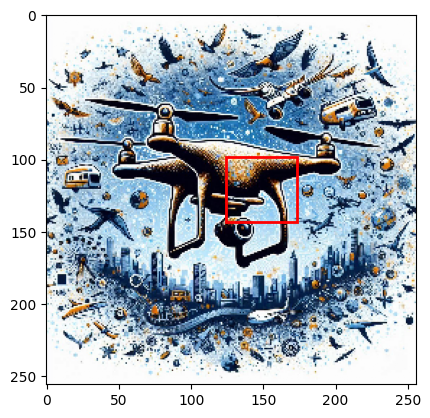

In [17]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches

# Load an example image (replace with your actual image)
img = testImages[0]  # Use the first image in your test set

fig, ax = plt.subplots(1)
ax.imshow(img)

# Convert normalized coordinates to absolute pixel values
x_min_abs = int(0.48746118 * img.shape[1])  # img.shape[1] is the width of the image
y_min_abs = int(0.3862716 * img.shape[0])   # img.shape[0] is the height of the image
x_max_abs = int(0.6777698 * img.shape[1])
y_max_abs = int(0.56178486 * img.shape[0])

# Draw a rectangle (bounding box)
rect = patches.Rectangle((x_min_abs, y_min_abs), x_max_abs - x_min_abs, y_max_abs - y_min_abs, 
                         linewidth=2, edgecolor='r', facecolor='none')
ax.add_patch(rect)

plt.show()


### Predicting and Visualizing Bounding Boxes on Test Images

- Loaded the VGG16 model and test images, ensuring proper preprocessing and handling errors for image loading.
- Made predictions on the test images, converting normalized bounding box coordinates to absolute pixel values.
- Visualized each test image with its predicted bounding box drawn in red, using `matplotlib`.


Loaded image D:\Projects\DRONE DETECTION SYSTEM\test photos\test_image_1.jpeg with shape: (256, 256, 3)
Loaded image D:\Projects\DRONE DETECTION SYSTEM\test photos\test_image_2.jpeg with shape: (256, 256, 3)
Loaded image D:\Projects\DRONE DETECTION SYSTEM\test photos\test_image_3.jpeg with shape: (256, 256, 3)
Loaded image D:\Projects\DRONE DETECTION SYSTEM\test photos\test_image_4.jpeg with shape: (256, 256, 3)
Loaded image D:\Projects\DRONE DETECTION SYSTEM\test photos\test_image_6.jpeg with shape: (256, 256, 3)


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 867ms/step


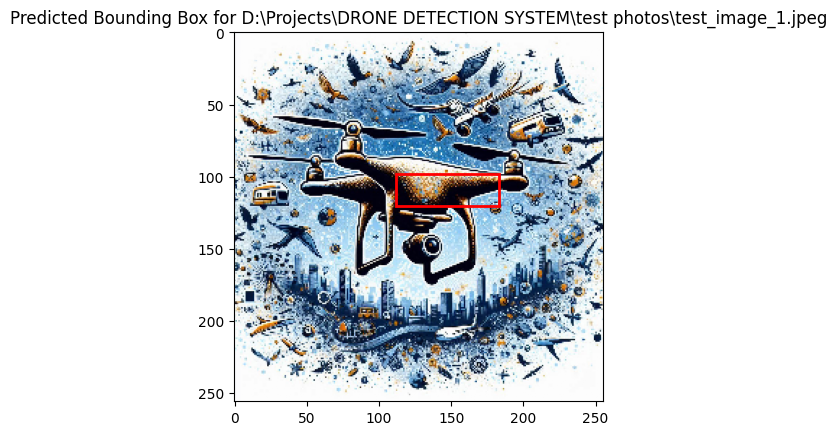

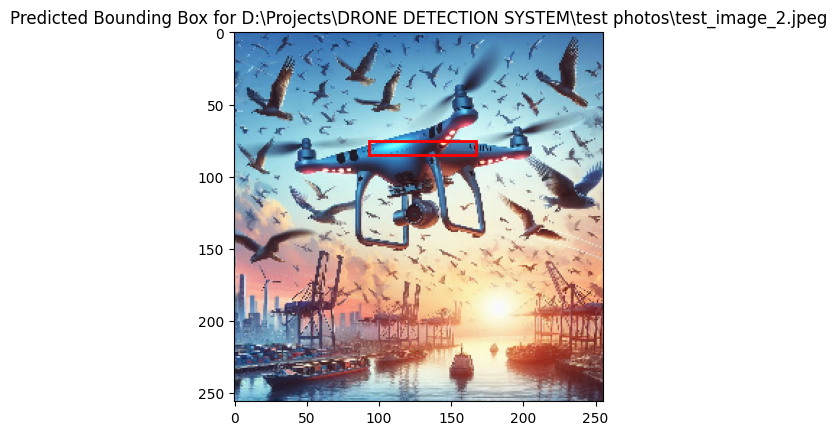

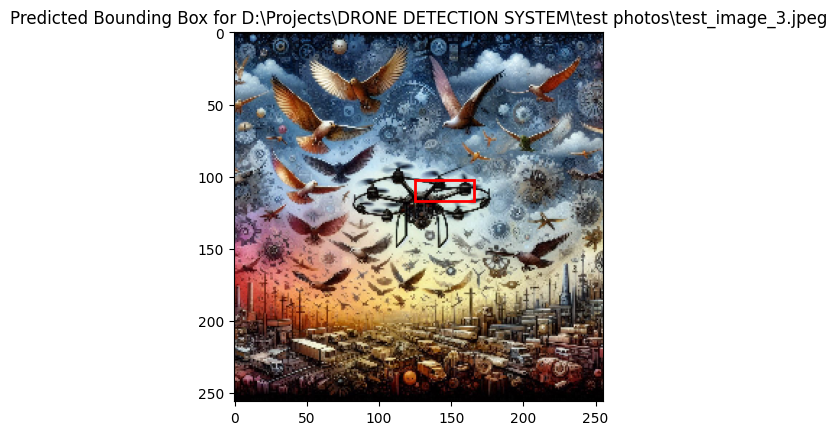

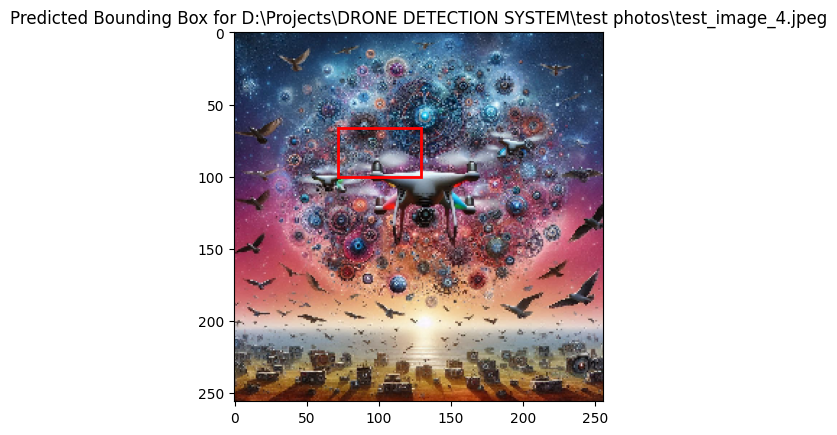

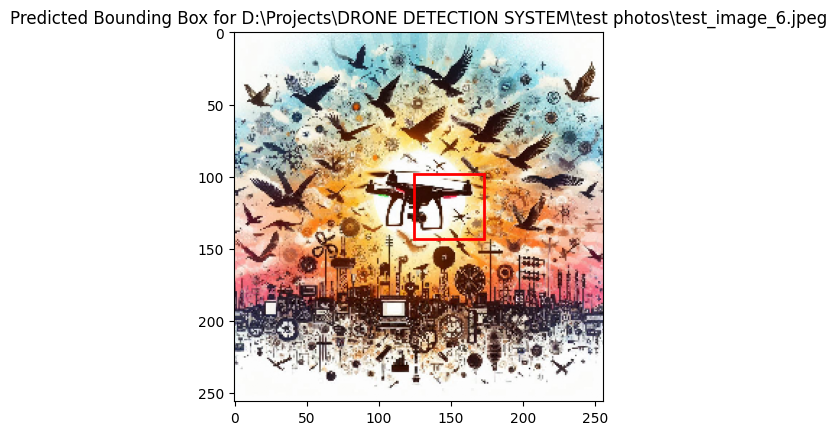

In [19]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing.image import load_img, img_to_array
import glob
import os
import matplotlib.patches as patches

# Load the model with custom objects
model_path_h5 = r"D:\Projects\DRONE DETECTION SYSTEM\VGGModel.h5"
vggmodel = tf.keras.models.load_model(model_path_h5, custom_objects={'mse': tf.keras.losses.MeanSquaredError()})

# Path to your test images folder
test_images_path = r"D:\Projects\DRONE DETECTION SYSTEM\test photos\*.jpeg"  # Updated to look for .jpeg files

# Load and preprocess the test images
test_images_files = glob.glob(test_images_path)
testImages = []

# Check if any files were found
if not test_images_files:
    raise ValueError("No .jpeg image files found in the specified directory.")

for file in test_images_files:
    try:
        # Load and resize the image
        img = load_img(file, target_size=(256, 256))  
        img_array = img_to_array(img) / 255.0  # Convert to array and normalize
        
        # Debugging: print the shape of the loaded image
        print(f"Loaded image {file} with shape: {img_array.shape}")

        # Check for image shape and ensure it is correct
        if img_array.shape == (256, 256, 3): 
            testImages.append(img_array)
        else:
            print(f"Skipping file {file} due to incorrect shape: {img_array.shape}")
            
    except Exception as e:
        print(f"Error loading image {file}: {e}")

# Ensure there are images loaded for prediction
if len(testImages) == 0:
    raise ValueError("No valid images found for prediction!")

testImages = np.array(testImages)  # Convert list to numpy array

# Make predictions on the test images
predictions = vggmodel.predict(testImages, verbose=1)

# Display results: visualize the test images with their predicted bounding boxes
for i, file in enumerate(test_images_files[:len(testImages)]):
    # Convert normalized coordinates to absolute pixel values
    x_min_abs = int(predictions[i][0] * testImages[i].shape[1])  # img.shape[1] is the width of the image
    y_min_abs = int(predictions[i][1] * testImages[i].shape[0])  # img.shape[0] is the height of the image
    x_max_abs = int(predictions[i][2] * testImages[i].shape[1])
    y_max_abs = int(predictions[i][3] * testImages[i].shape[0])
    
    # Create a figure and axis to draw the bounding box
    fig, ax = plt.subplots(1)
    ax.imshow(testImages[i])
    
    # Draw a rectangle (bounding box) in red color
    rect = patches.Rectangle((x_min_abs, y_min_abs), x_max_abs - x_min_abs, y_max_abs - y_min_abs, 
                             linewidth=2, edgecolor='r', facecolor='none')
    ax.add_patch(rect)

    # Display the image with the bounding box
    plt.title(f"Predicted Bounding Box for {file}")
    plt.show()


### Real-Time Drone Detection in Video

- Loaded the VGG16 model and recompiled it with metrics for video prediction.
- Processed the video frame-by-frame using OpenCV, converting frames to RGB, resizing, and normalizing them for the model.
- Made predictions on each frame, converting normalized bounding box coordinates to absolute pixel values.
- Drew bounding boxes around detected drones on the video frames and displayed the results in real-time.
- Allowed manual exit from video display by pressing 'q', and ensured proper cleanup of video capture and OpenCV windows.


In [29]:
import tensorflow as tf
import numpy as np
import cv2  # OpenCV for video processing
from tensorflow.keras.preprocessing.image import img_to_array

# Load the model with custom objects
model_path_h5 = r"D:\Projects\DRONE DETECTION SYSTEM\VGGModel.h5"
vggmodel = tf.keras.models.load_model(model_path_h5, custom_objects={'mse': tf.keras.losses.MeanSquaredError()})

# Recompile the model with metrics before prediction
vggmodel.compile(optimizer='adam', loss='mse', metrics=['accuracy'])

# Path to the video
video_path = r"D:\Projects\DRONE DETECTION SYSTEM\test videos\video 1.mp4"

# Read the video
cap = cv2.VideoCapture(video_path)

# Check if the video was opened successfully
if not cap.isOpened():
    print("Error opening video file.")
    exit()

# Process the video frame-by-frame
while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break  # Exit the loop if no frame is returned (end of video)

    # Convert frame from BGR to RGB
    frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)

    # Resize frame to match the model's input size
    frame_resized = cv2.resize(frame_rgb, (256, 256))

    # Convert to array and normalize
    img_array = img_to_array(frame_resized) / 255.0
    img_array = np.expand_dims(img_array, axis=0)  # Add batch dimension

    # Make predictions on the current frame
    predictions = vggmodel.predict(img_array, verbose=0)[0]

    # Convert normalized coordinates to absolute pixel values
    x_min_abs = int(predictions[0] * frame.shape[1])
    y_min_abs = int(predictions[1] * frame.shape[0])
    x_max_abs = int(predictions[2] * frame.shape[1])
    y_max_abs = int(predictions[3] * frame.shape[0])

    # Draw bounding box if a drone is detected
    if x_max_abs - x_min_abs > 0 and y_max_abs - y_min_abs > 0:  # Ensure bounding box is valid
        # Draw a red rectangle (bounding box) around the detected drone
        cv2.rectangle(frame, (x_min_abs, y_min_abs), (x_max_abs, y_max_abs), (0, 0, 255), 2)

    # Display the resulting frame
    cv2.imshow('Drone Detection', frame)

    # Press 'q' to exit the video display
    if cv2.waitKey(25) & 0xFF == ord('q'):
        break

# Release the video capture object and close all OpenCV windows
cap.release()
cv2.destroyAllWindows()


## Performance
### Acccuracy vs No. of epochs graph
- Printed the final training and validation accuracy values from the training history.
- Plotted training and validation accuracy over epochs to visualize model performance during training.
- Labeled the axes and added a legend to the accuracy plot for clarity.

Final Training Accuracy: 0.9314928650856018
Final Validation Accuracy: 0.7714285850524902


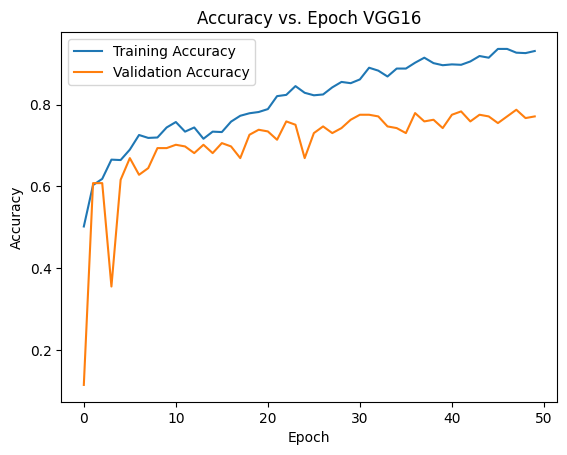

In [15]:
print('Final Training Accuracy:', historyvgg.history['accuracy'][-1])
print('Final Validation Accuracy:', historyvgg.history['val_accuracy'][-1])

plt.plot(historyvgg.history['accuracy'], label='Training Accuracy')
plt.plot(historyvgg.history['val_accuracy'], label='Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.title('Accuracy vs. Epoch VGG16')
plt.legend()
plt.show()

### Loss vs No. of epochs graph
- Printed the final training and validation loss values from the training history.
- Plotted training and validation loss over epochs to visualize model performance during training.
- Labeled the axes and added a legend to the loss plot for clarity.

Final Training Loss: 0.0012029894860461354
Final Validation Loss: 0.015476125292479992


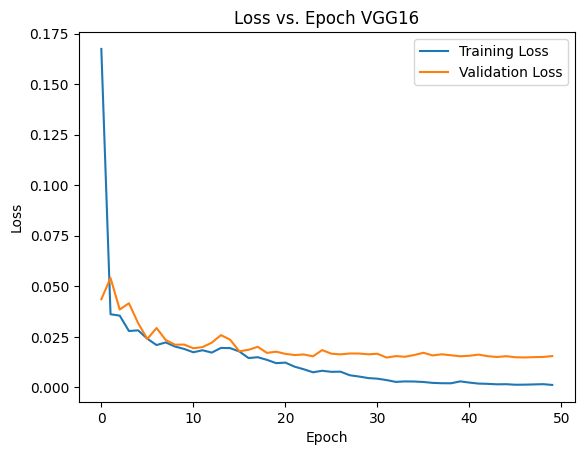

In [16]:
print('Final Training Loss:', historyvgg.history['loss'][-1])
print('Final Validation Loss:', historyvgg.history['val_loss'][-1])

plt.plot(historyvgg.history['loss'], label='Training Loss')
plt.plot(historyvgg.history['val_loss'], label='Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Loss vs. Epoch VGG16')
plt.legend()
plt.show()

### Evaluating on test images

- Evaluated the model on the test dataset and printed the test loss and accuracy.


In [17]:
loss, accuracy = vggmodel.evaluate(testImages, testTargets, verbose=1)
print("Test Loss:", loss)
print("Test Accuracy:", accuracy)

5/5 ━━━━━━━━━━━━━━━━━━━━ 16s 3s/step - accuracy: 0.7279 - loss: 0.0186
Test Loss: 0.017393803223967552
Test Accuracy: 0.75


# Resnet50
- ResNet50 is a deep convolutional neural network designed for image classification tasks.
- It uses residual blocks to mitigate vanishing gradient problems and improve training of very deep networks.
- Useful for feature extraction, image classification, and transfer learning.
- Best for improving model performance in complex image recognition tasks.
- Effective in drone detection systems by learning intricate patterns and features, enhancing detection accuracy.




### Building a Custom ResNet50 Model

- Loaded the ResNet50 model with pre-trained weights, excluding top layers for feature extraction.
- Made the ResNet50 model trainable and added a custom bounding box head with dense layers.
- The model outputs a 4-dimensional vector representing bounding box coordinates.
- Displayed the model summary to review its architecture.


In [3]:
import tensorflow as tf  # Import TensorFlow
from tensorflow.keras.layers import Dense, Flatten
from tensorflow.keras import Model, Input

def build_resnetmodel():
    resnet = tf.keras.applications.ResNet50(weights="imagenet", include_top=False, input_tensor=Input(shape=(256, 256, 3)))

    resnet.trainable = True

    flatten = resnet.output
    flatten = Flatten()(flatten)

    bboxHead = Dense(128, activation="relu")(flatten)
    bboxHead = Dense(64, activation="relu")(bboxHead)
    bboxHead = Dense(32, activation="relu")(bboxHead)
    bboxHead = Dense(4, activation="linear")(bboxHead)

    resnetmodel = Model(inputs=resnet.input, outputs=bboxHead)
    
    return resnetmodel

resnetmodel = build_resnetmodel()

resnetmodel.summary()


Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 256, 256,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_pad           │ (None, 262, 262,  │          0 │ input_layer[0][0] │
│ (ZeroPadding2D)     │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_conv (Conv2D) │ (None, 128, 128,  │      9,472 │ conv1_pad[0][0]   │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_bn            │ (None, 128, 128,  │        256 │ conv1_conv[0][0]  │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_relu          │ (None, 128, 128,  │          0 │ conv1_bn[0][0]    │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1_pad           │ (None, 130, 130,  │          0 │ conv1_relu[0][0]  │
│ (ZeroPadding2D)     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1_pool          │ (None, 64, 64,    │          0 │ pool1_pad[0][0]   │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_conv │ (None, 64, 64,    │      4,160 │ pool1_pool[0][0]  │
│ (Conv2D)            │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_bn   │ (None, 64, 64,    │        256 │ conv2_block1_1_c… │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_relu │ (None, 64, 64,    │          0 │ conv2_block1_1_b… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_conv │ (None, 64, 64,    │     36,928 │ conv2_block1_1_r… │
│ (Conv2D)            │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_bn   │ (None, 64, 64,    │        256 │ conv2_block1_2_c… │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_relu │ (None, 64, 64,    │          0 │ conv2_block1_2_b… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_0_conv │ (None, 64, 64,    │     16,640 │ pool1_pool[0][0]  │
│ (Conv2D)            │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_3_conv │ (None, 64, 64,    │     16,640 │ conv2_block1_2_r… │
│ (Conv2D)            │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_0_bn   │ (None, 64, 64,    │      1,024 │ conv2_block1_0_c… │
│ (BatchNormalizatio… │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_3_bn   │ (None, 64, 64,    │      1,024 │ conv2_block1_3_c

 Total params: 40,375,524 (154.02 MB)

 Trainable params: 40,322,404 (153.82 MB)

 Non-trainable params: 53,120 (207.50 KB)

## Compiling and training the model


- Converted image and annotation lists to numpy arrays and normalized the images.
- Split the dataset into training and testing sets with a 90-10 split.
- Compiled the ResNet50 model using the Adam optimizer and mean squared error (MSE) loss function.
- Trained the model on the training data for 50 epochs, with model checkpointing to save the best model.


In [13]:
import numpy as np
from sklearn.model_selection import train_test_split

# Convert image and annotation lists to numpy arrays and normalize
data = np.array(train_image, dtype='float32') / 255.0  # Normalize the images
targets = np.array(train_annotation, dtype='float32')

# Split the dataset into training and testing sets
trainImages, testImages, trainTargets, testTargets = train_test_split(data, targets, test_size=0.1, random_state=42)

# Now compile and fit the model
resnetmodel.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.001), loss='mse', metrics=['accuracy'])

save_best = tf.keras.callbacks.ModelCheckpoint("RESNETModel.keras", verbose=1)

historyresnet = resnetmodel.fit(
    trainImages, trainTargets,
    validation_split=0.2,
    batch_size=16,
    epochs=50,
    verbose=1,
    callbacks=[save_best]
)


Epoch 1/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 5s/step - accuracy: 0.3927 - loss: 47.0427
Epoch 1: saving model to RESNETModel.keras
62/62 ━━━━━━━━━━━━━━━━━━━━ 374s 5s/step - accuracy: 0.3936 - loss: 46.5129 - val_accuracy: 0.1143 - val_loss: 4.3850
Epoch 2/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 5s/step - accuracy: 0.5987 - loss: 0.0398
Epoch 2: saving model to RESNETModel.keras
62/62 ━━━━━━━━━━━━━━━━━━━━ 323s 5s/step - accuracy: 0.5986 - loss: 0.0398 - val_accuracy: 0.1224 - val_loss: 0.0563
Epoch 3/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 5s/step - accuracy: 0.7079 - loss: 0.0271
Epoch 3: saving model to RESNETModel.keras
62/62 ━━━━━━━━━━━━━━━━━━━━ 304s 5s/step - accuracy: 0.7075 - loss: 0.0271 - val_accuracy: 0.1551 - val_loss: 0.0887
Epoch 4/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 4s/step - accuracy: 0.6643 - loss: 0.0268
Epoch 4: saving model to RESNETModel.keras
62/62 ━━━━━━━━━━━━━━━━━━━━ 297s 5s/step - accuracy: 0.6647 - loss: 0.0268 - val_accuracy: 0.1551 - val_loss: 0.1469
Epoch 5/50
62/62 ━━━━━━━━━━━━━

### Loading and Predicting with the ResNet50 Model

- Loaded the pre-trained ResNet50 model from a `.keras` file.
- Used the loaded model to make predictions on a subset of 10 test images.
- Printed the predicted bounding box coordinates for each test image.


In [16]:
import tensorflow as tf

# Provide the correct path to the model file
model_path = r"D:\Projects\DRONE DETECTION SYSTEM\RESNETModel.keras"  # Change to the correct extension if needed

# Load the model
resnetmodel = tf.keras.models.load_model(model_path)

# Predict using the loaded model
predictions = resnetmodel.predict(testImages[:10], verbose=1)

print(predictions)


1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step
[[0.49431667 0.42461047 0.9817029  0.53858995]
 [0.46992534 0.50368845 0.81439596 0.61441195]
 [0.53652644 0.3693376  0.5275812  0.34011495]
 [0.46923763 0.40155268 0.69414973 0.61239684]
 [0.520918   0.39283577 0.84770626 0.48387992]
 [0.52219236 0.4020407  0.84529436 0.5944327 ]
 [0.5430019  0.36862794 0.47523555 0.25999105]
 [0.57533276 0.38000175 0.805969   0.4464497 ]
 [0.43505153 0.36920235 0.7287429  0.525696  ]
 [0.5251136  0.49025777 0.93547595 0.5722029 ]]


- Saved the trained ResNet50 model in HDF5 format as `RESNETModel.h5` for future use.


In [18]:
# Save the model in HDF5 format (.h5)
resnetmodel.save('RESNETModel.h5')


### Model Loading and Image Prediction
- Loaded a pre-trained ResNet model for drone detection.
- Loaded, resized, and normalized test images, ensuring correct dimensions.
- Made predictions on the test images, calculated bounding box areas, and visualized the top two predictions with bounding boxes.

Model loaded successfully.
Loaded image D:\Projects\DRONE DETECTION SYSTEM\test photos\test_image_1.jpeg with shape: (256, 256, 3)
Loaded image D:\Projects\DRONE DETECTION SYSTEM\test photos\test_image_2.jpeg with shape: (256, 256, 3)
Loaded image D:\Projects\DRONE DETECTION SYSTEM\test photos\test_image_3.jpeg with shape: (256, 256, 3)
Loaded image D:\Projects\DRONE DETECTION SYSTEM\test photos\test_image_4.jpeg with shape: (256, 256, 3)
Loaded image D:\Projects\DRONE DETECTION SYSTEM\test photos\test_image_6.jpeg with shape: (256, 256, 3)
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


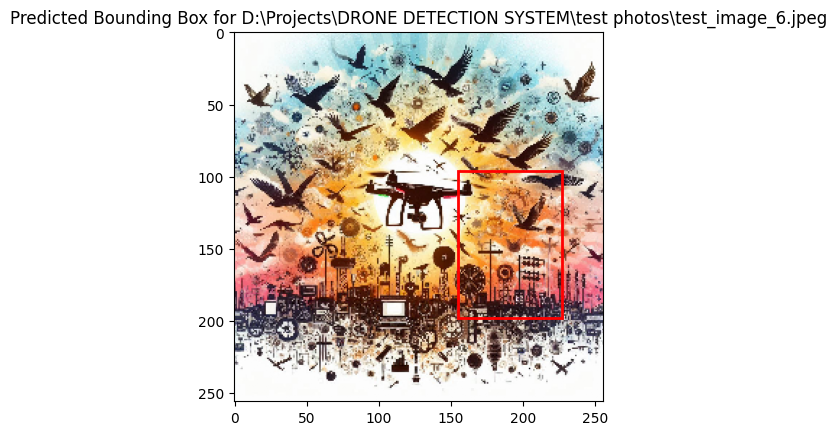

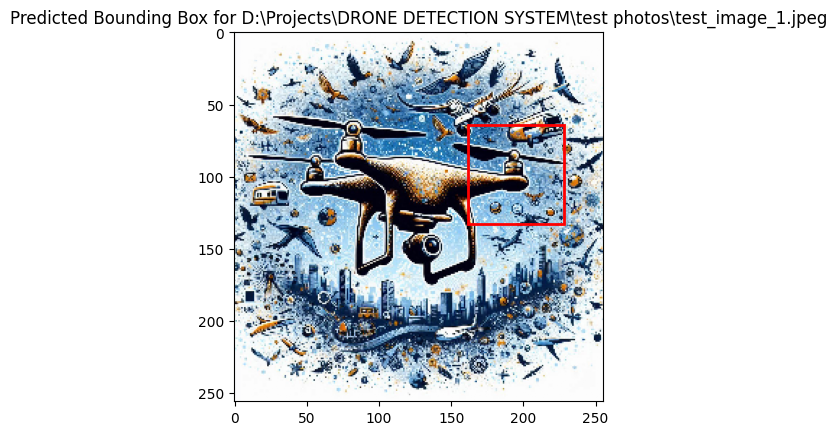

In [6]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing.image import load_img, img_to_array
import glob
import os
import matplotlib.patches as patches
from tensorflow.keras.models import load_model

# Load the saved model with custom objects
model_path = 'D:/Projects/DRONE DETECTION SYSTEM/RESNETModel.h5'
loaded_model = load_model(model_path, custom_objects={'mse': tf.keras.losses.MeanSquaredError()})
print("Model loaded successfully.")

# Path to your test images folder
test_images_path = r"D:\Projects\DRONE DETECTION SYSTEM\test photos\*.jpeg"  # Look for .jpeg files

# Load and preprocess the test images
test_images_files = glob.glob(test_images_path)
testImages = []

# Check if any files were found
if not test_images_files:
    raise ValueError("No .jpeg image files found in the specified directory.")

for file in test_images_files:
    try:
        # Load and resize the image
        img = load_img(file, target_size=(256, 256))  
        img_array = img_to_array(img) / 255.0  # Convert to array and normalize
        
        # Debugging: print the shape of the loaded image
        print(f"Loaded image {file} with shape: {img_array.shape}")

        # Check for image shape and ensure it is correct
        if img_array.shape == (256, 256, 3): 
            testImages.append((file, img_array))  # Store the file name along with the image array
        else:
            print(f"Skipping file {file} due to incorrect shape: {img_array.shape}")
            
    except Exception as e:
        print(f"Error loading image {file}: {e}")

# Ensure there are images loaded for prediction
if len(testImages) == 0:
    raise ValueError("No valid images found for prediction!")

# Prepare images for prediction
images = np.array([img[1] for img in testImages])  # Extract image arrays
file_names = [img[0] for img in testImages]  # Extract file names

# Make predictions on the test images
predictions = loaded_model.predict(images, verbose=1)

# Calculate prediction accuracy (for example, using inverse of bounding box area as a simple heuristic)
accuracies = [(i, abs((pred[2] - pred[0]) * (pred[3] - pred[1]))) for i, pred in enumerate(predictions)]

# Sort images by the calculated accuracy (higher is better) and get the top 2
top_two_indices = sorted(accuracies, key=lambda x: x[1], reverse=True)[:2]

# Display results: visualize the top 2 test images with their predicted bounding boxes
for idx, _ in top_two_indices:
    file = file_names[idx]
    img = images[idx]
    pred = predictions[idx]
    
    # Convert normalized coordinates to absolute pixel values
    x_min_abs = int(pred[0] * img.shape[1])  # img.shape[1] is the width of the image
    y_min_abs = int(pred[1] * img.shape[0])  # img.shape[0] is the height of the image
    x_max_abs = int(pred[2] * img.shape[1])
    y_max_abs = int(pred[3] * img.shape[0])
    
    # Create a figure and axis to draw the bounding box
    fig, ax = plt.subplots(1)
    ax.imshow(img)
    
    # Draw a rectangle (bounding box) in red color
    rect = patches.Rectangle((x_min_abs, y_min_abs), x_max_abs - x_min_abs, y_max_abs - y_min_abs, 
                             linewidth=2, edgecolor='r', facecolor='none')
    ax.add_patch(rect)

    # Display the image with the bounding box
    plt.title(f"Predicted Bounding Box for {file}")
    plt.show()


- Updated `detect_drones_with_confidence()` function to include confidence scores in predictions.
- Added a confidence threshold to only draw bounding boxes if the confidence exceeds `0.5`, improving the accuracy of detections.

In [7]:
# Modify this part to handle confidence scores
# Assuming the model outputs a confidence score along with bounding boxes
def detect_drones_with_confidence(image, model):
    # Resize and normalize the image
    resized_image = cv2.resize(image, (256, 256))
    normalized_image = resized_image / 255.0
    input_image = np.expand_dims(normalized_image, axis=0)

    # Predict bounding boxes and confidence
    predictions = model.predict(input_image)
    startX, startY, endX, endY, confidence = predictions[0]  # Adjust according to your model's output format

    # Only draw a bounding box if the confidence is above a certain threshold
    if confidence > 0.5:  # Adjust the threshold as needed
        h_ratio, w_ratio = image.shape[0] / 256, image.shape[1] / 256
        startX, startY, endX, endY = int(startX * w_ratio), int(startY * h_ratio), int(endX * w_ratio), int(endY * h_ratio)
        cv2.rectangle(image, (startX, startY), (endX, endY), (0, 0, 255), 2)  # Red bounding box
    else:
        print(f"Low confidence: {confidence}, skipping detection.")
    
    return image


### Drone Detection in Video Using Pre-trained Model

- Loaded a pre-trained ResNet model for drone detection and defined functions for processing.
- Implemented `detect_drones()` to resize, normalize, predict bounding boxes, and draw them on frames.
- Created `process_video()` to open a video file, apply drone detection frame-by-frame, and display results in a resized window.
- The script allows real-time detection and visualization of drones in video footage.


In [12]:
import cv2
import numpy as np
from tensorflow.keras.models import load_model
import tensorflow as tf

# Load the saved model with custom objects
model_path = 'D:/Projects/DRONE DETECTION SYSTEM/RESNETModel.h5'
loaded_model = load_model(model_path, custom_objects={'mse': tf.keras.losses.MeanSquaredError()})
print("Model loaded successfully.")

# Function to detect drones in a frame
def detect_drones(image, model):
    # Resize and normalize the image
    resized_image = cv2.resize(image, (256, 256))
    normalized_image = resized_image / 255.0
    input_image = np.expand_dims(normalized_image, axis=0)

    # Predict bounding boxes
    predictions = model.predict(input_image)
    startX, startY, endX, endY = predictions[0]  # Adjust according to your model's output format

    # Convert normalized coordinates to absolute pixel values
    h_ratio, w_ratio = image.shape[0] / 256, image.shape[1] / 256
    startX, startY, endX, endY = int(startX * w_ratio), int(startY * h_ratio), int(endX * w_ratio), int(endY * h_ratio)

    # Draw a bounding box on the image
    cv2.rectangle(image, (startX, startY), (endX, endY), (0, 0, 255), 2)  # Red bounding box
    
    return image

# Function to process video, detect drones, and display in a smaller frame
def process_video(video_path, model):
    cap = cv2.VideoCapture(video_path)

    # Check if video opened successfully
    if not cap.isOpened():
        print("Error: Could not open video.")
        return

    # Set the desired frame size for display
    display_width, display_height = 640, 480  # Adjust to desired size

    while cap.isOpened():
        ret, frame = cap.read()
        if not ret:
            break

        # Detect drones in the current frame
        detected_frame = detect_drones(frame, model)

        # Resize the frame for display
        smaller_frame = cv2.resize(detected_frame, (display_width, display_height))

        # Display the frame with detections
        cv2.imshow('Drone Detection', smaller_frame)

        # Press 'q' to quit
        if cv2.waitKey(1) & 0xFF == ord('q'):
            break

    # Release video resources
    cap.release()
    cv2.destroyAllWindows()

# Example Usage:
video_path = 'D:/Projects/DRONE DETECTION SYSTEM/test videos/video 1.mp4'  # Replace with your video path
process_video(video_path, loaded_model)


Model loaded successfully.
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step
1/

### Evaluating ResNet50 Training and Validation Accuracy

- Printed the final training and validation accuracy values from the ResNet50 model's training history.
- Plotted the training and validation accuracy over epochs to visualize performance improvements.
- Added labels and a legend to the plot for better clarity and understanding.


Final Training Accuracy: 0.8977504968643188
Final Validation Accuracy: 0.7632653117179871


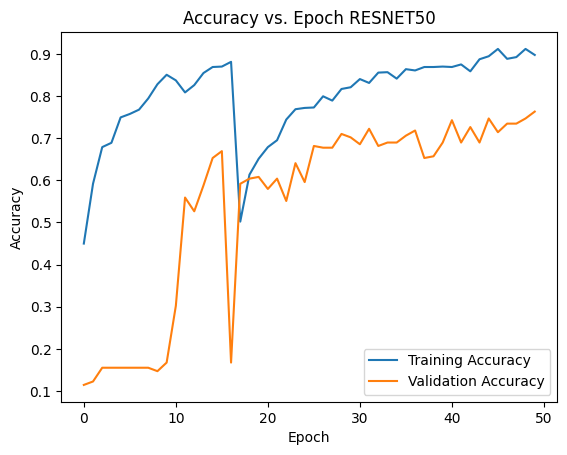

In [19]:
print('Final Training Accuracy:', historyresnet.history['accuracy'][-1])
print('Final Validation Accuracy:', historyresnet.history['val_accuracy'][-1])

plt.plot(historyresnet.history['accuracy'], label='Training Accuracy')
plt.plot(historyresnet.history['val_accuracy'], label='Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.title('Accuracy vs. Epoch RESNET50')
plt.legend()
plt.show()

### Evaluating ResNet50 Training and Validation Loss

- Printed the final training and validation loss values from the ResNet50 model's training history.
- Plotted the training and validation loss over epochs to observe the model's learning process.
- Included labels and a legend in the plot for better clarity and understanding.


Final Training Loss: 0.0025375818368047476
Final Validation Loss: 0.014830050989985466


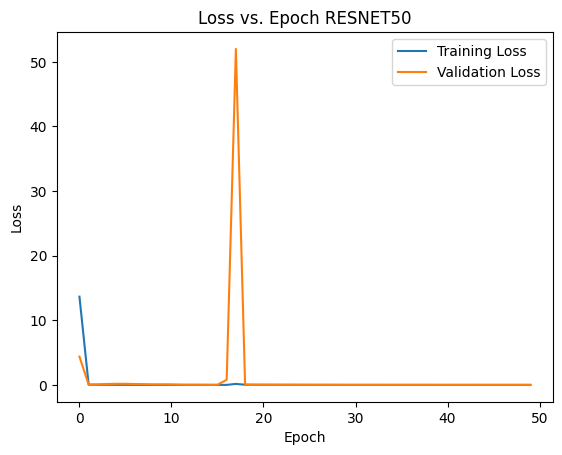

In [20]:
print('Final Training Loss:', historyresnet.history['loss'][-1])
print('Final Validation Loss:', historyresnet.history['val_loss'][-1])

plt.plot(historyresnet.history['loss'], label='Training Loss')
plt.plot(historyresnet.history['val_loss'], label='Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Loss vs. Epoch RESNET50')
plt.legend()
plt.show()

- Evaluated the ResNet50 model on the test dataset and printed the test loss and accuracy.


In [21]:
loss, accuracy = resnetmodel.evaluate(testImages, testTargets, verbose=1)
print("Test Loss:", loss)
print("Test Accuracy:", accuracy)

5/5 ━━━━━━━━━━━━━━━━━━━━ 12s 2s/step - accuracy: 0.7556 - loss: 0.0189
Test Loss: 0.017880769446492195
Test Accuracy: 0.7720588445663452


####  Installed the `ultralytics` package, which includes tools like YOLO for object detection.


In [22]:
pip install -q ultralytics

### Collecting Image and Label Paths for Dataset

- Defined the dataset directory path and initialized lists for image and label paths.
- Gathered all image paths with the `.jpg` extension in the dataset folder.
- For each image, collected the corresponding label paths (with `.txt` extension) and verified their existence.
- Displayed the progress of image processing and printed the total number of images and labels found.


In [24]:
import os
import glob
import shutil
from tqdm import tqdm

# Define the directory path where the dataset is stored
DATA_DIR = "D:/Projects/DRONE DETECTION SYSTEM/archive/drone_dataset_yolo/dataset_txt"

# Initialize lists to store image paths and corresponding label paths
images = []
labels = []

# Get all image paths with .jpg extension in the specified directory
image_paths = glob.glob(os.path.join(DATA_DIR, "*.jpg"))

# Loop through each image path and collect the corresponding label paths
for image_path in tqdm(image_paths, desc="Processing Images"):  # Display progress bar with description
    images.append(image_path)
    
    # Construct the label path by replacing the file extension
    label_path = os.path.splitext(image_path)[0] + '.txt'
    if os.path.exists(label_path):  # Check if the label file exists
        labels.append(label_path)
    else:
        print(f"Label file not found for {image_path}")

print(f"Total images: {len(images)}")
print(f"Total labels: {len(labels)}")


Processing Images: 100%|██████████| 1359/1359 [00:00<00:00, 8882.24it/s]

Total images: 1359
Total labels: 1359


### Splitting Dataset into Training and Testing Sets

- Split the collected image and label paths into training (90%) and testing (10%) sets using `train_test_split`.
- Ensured random shuffling of data with a fixed seed (`random_state=42`) for reproducibility.


In [25]:
from sklearn.model_selection import train_test_split
split = train_test_split(images, labels, test_size=0.10, random_state=42)

(trainImages, testImages) = split[:2]
(trainTargets, testTargets) = split[2:4]

### Organizing Training and Validation Data

- Created directories for training and validation images and labels if they didn't already exist.
- Copied the training and testing images into their respective directories (`train/images`, `valid/images`).
- Transferred the corresponding label files into their respective directories (`train/labels`, `valid/labels`).
- Used `tqdm` to track the progress of file copying for images and labels.


In [26]:
TRAIN_IMAGE_DIR = 'train/images'
TRAIN_LABEL_DIR = 'train/labels'
VAL_IMAGE_DIR = 'valid/images'
VAL_LABEL_DIR = 'valid/labels'

os.makedirs(TRAIN_IMAGE_DIR, exist_ok=True)
os.makedirs(TRAIN_LABEL_DIR, exist_ok=True)

os.makedirs(VAL_IMAGE_DIR, exist_ok=True)
os.makedirs(VAL_LABEL_DIR, exist_ok=True)

for path in tqdm(trainImages):
    shutil.copyfile(path, os.path.join(TRAIN_IMAGE_DIR, os.path.basename(path)))

for path in tqdm(testImages):
    shutil.copyfile(path, os.path.join(VAL_IMAGE_DIR, os.path.basename(path)))

for path in tqdm(trainTargets):
    shutil.copyfile(path, os.path.join(TRAIN_LABEL_DIR, os.path.basename(path)))

for path in tqdm(testTargets):
    shutil.copyfile(path, os.path.join(VAL_LABEL_DIR, os.path.basename(path)))

100%|██████████| 136/136 [00:00<00:00, 1301.52it/s]


### Creating YOLO Dataset Configuration File

- Created a `drone.yaml` file specifying paths for training and validation images.
- Defined the number of classes (`nc: 1`) and provided class names (`names: ['drone']`) for the dataset.


In [27]:
%%writefile drone.yaml

path: /kaggle/working
train: train/images
val: valid/images

nc: 1

# Classes
names: ['drone']

Writing drone.yaml


- Disabled Weights & Biases (W&B) logging by setting the environment variable `WANDB_DISABLED` to `true`.


In [28]:
import os
os.environ['WANDB_DISABLED'] = 'true'

- Loaded a pre-trained YOLOv8 model using the `.pt` file for training, which is recommended over building a new model from scratch.


In [29]:
from ultralytics import YOLO
# Load a model
# model = YOLO("yolov8s.yaml")  # build a new model from scratch
model = YOLO("yolov8s.pt")  # load a pretrained model (recommended for training)

100%|██████████| 21.5M/21.5M [00:18<00:00, 1.22MB/s]


### Training the YOLO Model

- Trained the YOLOv8 model using the dataset specified in `drone.yaml` with images resized to 256x256.
- Set the training parameters for 30 epochs and a batch size of 8, saving the model with the name `yolov8s_v8_50e`.


In [39]:
results = model.train(
    data='drone.yaml',
    imgsz=256,
    epochs=30,
    batch=8,
    name='yolov8s_v8_50e'
)


New https://pypi.org/project/ultralytics/8.2.95 available  Update with 'pip install -U ultralytics'
Ultralytics YOLOv8.2.90  Python-3.12.6 torch-2.4.1+cpu CPU (Intel Core(TM) i7-10750H 2.60GHz)
engine\trainer: task=detect, mode=train, model=yolov8s.pt, data=drone.yaml, epochs=30, time=None, patience=100, batch=8, imgsz=256, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=yolov8s_v8_50e3, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_fra

train: Scanning D:\Projects\DRONE DETECTION SYSTEM\train\labels... 1223 images, 0 backgrounds, 0 corrupt: 100%|██████████| 1223/1223 [00:01<00:00, 795.83it/s] 

train: WARNING  D:\Projects\DRONE DETECTION SYSTEM\train\images\pic_722.jpg: corrupt JPEG restored and saved


train: New cache created: D:\Projects\DRONE DETECTION SYSTEM\train\labels.cache


val: Scanning D:\Projects\DRONE DETECTION SYSTEM\valid\labels... 136 images, 0 backgrounds, 0 corrupt: 100%|██████████| 136/136 [00:00<00:00, 735.18it/s]

val: New cache created: D:\Projects\DRONE DETECTION SYSTEM\valid\labels.cache
Plotting labels to runs\detect\yolov8s_v8_50e3\labels.jpg... 


optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added 
Image sizes 256 train, 256 val
Using 0 dataloader workers
Logging results to runs\detect\yolov8s_v8_50e3
Starting training for 30 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/30         0G       1.55      1.413      1.455         15        256: 100%|██████████| 153/153 [02:48<00:00,  1.10s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:08<00:00,  1.01it/s]

                   all        136        154      0.834      0.727      0.763      0.441



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/30         0G      1.598      1.362      1.513         20        256: 100%|██████████| 153/153 [02:33<00:00,  1.00s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:06<00:00,  1.45it/s]

                   all        136        154      0.702       0.63      0.661      0.293



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/30         0G      1.653      1.382      1.552         22        256: 100%|██████████| 153/153 [02:30<00:00,  1.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:06<00:00,  1.42it/s]

                   all        136        154      0.635      0.571        0.6      0.267



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/30         0G      1.606      1.312      1.511         21        256: 100%|██████████| 153/153 [02:30<00:00,  1.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:06<00:00,  1.38it/s]

                   all        136        154      0.777      0.734      0.776       0.38



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/30         0G      1.508      1.203      1.438         25        256: 100%|██████████| 153/153 [02:30<00:00,  1.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:06<00:00,  1.40it/s]

                   all        136        154      0.772      0.749       0.81      0.474



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/30         0G       1.49      1.163      1.455         17        256: 100%|██████████| 153/153 [02:30<00:00,  1.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:06<00:00,  1.42it/s]

                   all        136        154       0.82      0.738      0.807      0.471



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/30         0G      1.451      1.157      1.428         18        256: 100%|██████████| 153/153 [02:28<00:00,  1.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:06<00:00,  1.43it/s]

                   all        136        154      0.852      0.749       0.82      0.492



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/30         0G      1.445      1.134      1.425         24        256: 100%|██████████| 153/153 [02:28<00:00,  1.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:06<00:00,  1.40it/s]

                   all        136        154      0.825      0.796      0.847      0.532



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/30         0G      1.421      1.053      1.409         19        256: 100%|██████████| 153/153 [02:29<00:00,  1.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:06<00:00,  1.43it/s]

                   all        136        154      0.843      0.838      0.857      0.521



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/30         0G      1.389      1.036      1.397         21        256: 100%|██████████| 153/153 [02:29<00:00,  1.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:06<00:00,  1.41it/s]

                   all        136        154      0.865      0.773      0.871      0.528



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/30         0G      1.365      1.014      1.398         21        256: 100%|██████████| 153/153 [02:28<00:00,  1.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:06<00:00,  1.43it/s]

                   all        136        154      0.869      0.792      0.845      0.544



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/30         0G      1.329     0.9501      1.358         18        256: 100%|██████████| 153/153 [02:28<00:00,  1.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:06<00:00,  1.43it/s]

                   all        136        154       0.87      0.869      0.877      0.568



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/30         0G      1.341     0.9566      1.358         14        256: 100%|██████████| 153/153 [02:29<00:00,  1.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:06<00:00,  1.42it/s]

                   all        136        154      0.917      0.862        0.9      0.579



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/30         0G      1.298     0.9243      1.338         22        256: 100%|██████████| 153/153 [02:28<00:00,  1.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:06<00:00,  1.44it/s]

                   all        136        154      0.893      0.825      0.886      0.569



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/30         0G       1.27     0.8853      1.317         16        256: 100%|██████████| 153/153 [02:28<00:00,  1.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:06<00:00,  1.43it/s]

                   all        136        154      0.929      0.854      0.887      0.599



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/30         0G      1.272     0.8748      1.316         17        256: 100%|██████████| 153/153 [02:29<00:00,  1.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:06<00:00,  1.43it/s]

                   all        136        154      0.964      0.872      0.896      0.599



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/30         0G      1.244     0.8483      1.307         21        256: 100%|██████████| 153/153 [02:29<00:00,  1.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:06<00:00,  1.42it/s]

                   all        136        154      0.899      0.864      0.886       0.61



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/30         0G       1.23     0.8141      1.305         16        256: 100%|██████████| 153/153 [02:28<00:00,  1.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:06<00:00,  1.42it/s]

                   all        136        154      0.943      0.857      0.906      0.624



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/30         0G      1.234     0.7924       1.29         14        256: 100%|██████████| 153/153 [02:28<00:00,  1.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:06<00:00,  1.44it/s]

                   all        136        154      0.904      0.853      0.878      0.594



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/30         0G      1.211     0.8138      1.287         15        256: 100%|██████████| 153/153 [02:29<00:00,  1.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:06<00:00,  1.37it/s]

                   all        136        154      0.939       0.87      0.904      0.622


Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/30         0G      1.088      0.658      1.225          7        256: 100%|██████████| 153/153 [02:28<00:00,  1.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:06<00:00,  1.43it/s]

                   all        136        154      0.929      0.857      0.908      0.618



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/30         0G      1.072     0.6094      1.219          9        256: 100%|██████████| 153/153 [02:28<00:00,  1.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:06<00:00,  1.42it/s]

                   all        136        154      0.936      0.838        0.9      0.628



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/30         0G      1.077     0.5988       1.22          7        256: 100%|██████████| 153/153 [02:27<00:00,  1.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:06<00:00,  1.42it/s]

                   all        136        154      0.929      0.877      0.898      0.639



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/30         0G       1.03     0.5759      1.192          7        256: 100%|██████████| 153/153 [02:27<00:00,  1.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:06<00:00,  1.43it/s]

                   all        136        154       0.96      0.825      0.898      0.639



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/30         0G     0.9929     0.5361       1.17          7        256: 100%|██████████| 153/153 [02:28<00:00,  1.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:06<00:00,  1.43it/s]

                   all        136        154      0.948      0.877      0.909      0.652



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/30         0G     0.9759     0.5286      1.161          7        256: 100%|██████████| 153/153 [02:28<00:00,  1.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:06<00:00,  1.40it/s]

                   all        136        154      0.949       0.85      0.906      0.637



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/30         0G     0.9553      0.511      1.151          7        256: 100%|██████████| 153/153 [02:28<00:00,  1.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:06<00:00,  1.40it/s]

                   all        136        154      0.978      0.855      0.912      0.655



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/30         0G      0.943     0.4881      1.143          7        256: 100%|██████████| 153/153 [02:29<00:00,  1.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:06<00:00,  1.42it/s]

                   all        136        154      0.973      0.877      0.917      0.659



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/30         0G     0.9233     0.4746      1.142          7        256: 100%|██████████| 153/153 [02:33<00:00,  1.00s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:06<00:00,  1.33it/s]

                   all        136        154      0.965      0.888      0.913      0.669



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/30         0G     0.8956     0.4654       1.12          8        256: 100%|██████████| 153/153 [02:29<00:00,  1.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:06<00:00,  1.42it/s]

                   all        136        154      0.969      0.883      0.913      0.665



30 epochs completed in 1.315 hours.
Optimizer stripped from runs\detect\yolov8s_v8_50e3\weights\last.pt, 22.5MB
Optimizer stripped from runs\detect\yolov8s_v8_50e3\weights\best.pt, 22.5MB

Validating runs\detect\yolov8s_v8_50e3\weights\best.pt...
Ultralytics YOLOv8.2.90  Python-3.12.6 torch-2.4.1+cpu CPU (Intel Core(TM) i7-10750H 2.60GHz)
Model summary (fused): 168 layers, 11,125,971 parameters, 0 gradients, 28.4 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:06<00:00,  1.45it/s]


                   all        136        154      0.965      0.888      0.913      0.668
Speed: 0.4ms preprocess, 28.8ms inference, 0.0ms loss, 0.3ms postprocess per image
Results saved to runs\detect\yolov8s_v8_50e3


### Visualizing Images in a Grid

- Defined a function `visualize` to plot images in a grid layout, allowing flexibility in the number of columns and samples.
- Used `glob` to gather image file paths and `random.sample` to select a subset of images if `num_samples` is specified.
- Configured the grid size based on the number of images and columns, and displayed the images with `matplotlib`.


In [40]:
import math
import random

# Plot and visualize images in a 2x2 grid.
def visualize(result_dir, num_samples=None, num_cols=1):
    """
    Function accepts a list of images and plots
    """
    image_names = sorted(glob.glob(os.path.join(result_dir, '*.jpg')))
    
    if num_samples is not None:
        image_names = random.sample(image_names, num_samples)
        
    num_images = len(image_names)
    num_rows = int(math.ceil(num_images / num_cols))
    plt.figure(figsize=(12 * num_cols, 6 * num_rows))
    
    for i, image_name in enumerate(image_names):
        image = plt.imread(image_name)
        plt.subplot(num_rows, num_cols, i+1)
        plt.imshow(image)
        plt.axis('off')
    plt.tight_layout()
    plt.show()


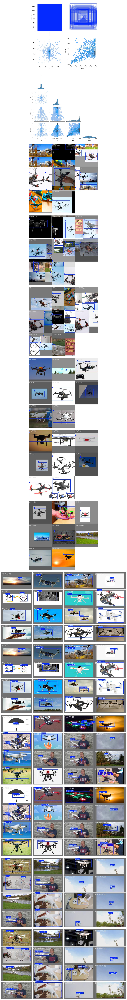

In [42]:
visualize('runs/detect/yolov8s_v8_50e3', num_cols=1)

- Ran inference on validation images using the YOLO model with confidence threshold of 0.5, non-maximum suppression, and IoU threshold of 0.5. Saved results and displayed the plotted results using `matplotlib`.



image 1/136 d:\Projects\DRONE DETECTION SYSTEM\valid\images\0032.jpg: 160x256 1 drone, 92.7ms
image 2/136 d:\Projects\DRONE DETECTION SYSTEM\valid\images\0046.jpg: 160x256 1 drone, 37.0ms
image 3/136 d:\Projects\DRONE DETECTION SYSTEM\valid\images\0064.jpg: 160x256 1 drone, 36.0ms
image 4/136 d:\Projects\DRONE DETECTION SYSTEM\valid\images\0065.jpg: 192x256 1 drone, 76.1ms
image 5/136 d:\Projects\DRONE DETECTION SYSTEM\valid\images\0072.jpg: 192x256 1 drone, 45.0ms
image 6/136 d:\Projects\DRONE DETECTION SYSTEM\valid\images\0074.jpg: 256x256 1 drone, 70.0ms
image 7/136 d:\Projects\DRONE DETECTION SYSTEM\valid\images\0084.jpg: 256x256 1 drone, 44.0ms
image 8/136 d:\Projects\DRONE DETECTION SYSTEM\valid\images\0089.jpg: 160x256 1 drone, 39.0ms
image 9/136 d:\Projects\DRONE DETECTION SYSTEM\valid\images\0091.jpg: 256x256 1 drone, 52.0ms
image 10/136 d:\Projects\DRONE DETECTION SYSTEM\valid\images\0093.jpg: 256x256 1 drone, 47.0ms
image 11/136 d:\Projects\DRONE DETECTION SYSTEM\valid\imag

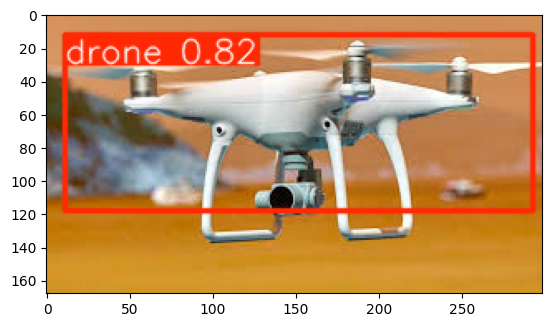

In [43]:
results = model("valid/images", conf=0.5, agnostic_nms=True, iou=0.5, save=True)
res_plotted = results[0].plot()
plt.imshow(res_plotted)
plt.show()


### Visualizing Random Inference Results

- Selected 10 random indices from the results and plotted them in a 2x5 grid layout.
- Used `matplotlib` to display each image with predicted bounding boxes, ensuring no axes are shown for clarity.


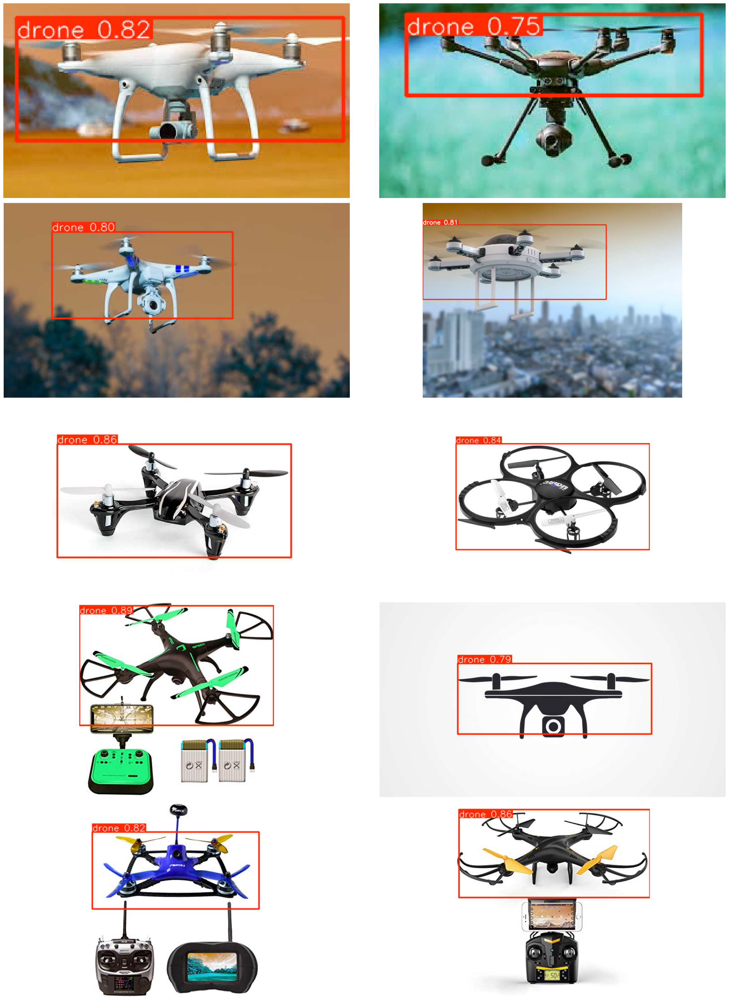

In [44]:
indices = list(range(len(results)))
random_indices = random.sample(indices, 10)
num_cols = 2
num_rows = 5

plt.figure(figsize=(12 * num_cols, 6 * num_rows))
    
for i, idx in enumerate(random_indices):
    image = results[i].plot()
    plt.subplot(num_rows, num_cols, i+1)
    plt.imshow(image)
    plt.axis('off')
plt.tight_layout()
plt.show()

### Video Processing with YOLO for Drone Detection

- Loaded a YOLOv8 model for drone detection and opened a video file for processing.
- Resized video frames to fit the display size while maintaining aspect ratio.
- Performed detection on each frame and drew bounding boxes around detected drones.
- Saved the annotated frames to a new video file and displayed real-time detection results.


In [1]:
import cv2
from ultralytics import YOLO

# Load the YOLOv8 model
model = YOLO('runs/detect/yolov8s_v8_50e3/weights/best.pt')  # Replace with your model path

# Open the video file
video_path = 'D:/Projects/DRONE DETECTION SYSTEM/test videos/video 1.mp4'  # Replace with your video path
cap = cv2.VideoCapture(video_path)

# Check if the video opened successfully
if not cap.isOpened():
    print("Error: Could not open video.")
    exit()

# Get the video frame width and height
frame_width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
frame_height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

# Define the desired frame size for display
display_width = 640  # Desired width of the display window
display_height = int(frame_height * (display_width / frame_width))  # Keep the aspect ratio

# Define the codec and create VideoWriter object to save the output video
output_path = 'output_video_with_detections.mp4'
out = cv2.VideoWriter(output_path, cv2.VideoWriter_fourcc(*'mp4v'), 30, (frame_width, frame_height))

# Process the video frame-by-frame
while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break

    # Resize the frame to the desired display size
    resized_frame = cv2.resize(frame, (display_width, display_height))

    # Convert the frame to RGB (YOLO expects RGB format)
    rgb_frame = cv2.cvtColor(resized_frame, cv2.COLOR_BGR2RGB)

    # Perform drone detection
    results = model.predict(rgb_frame, imgsz=256)

    # Draw bounding boxes on detected drones
    for result in results:
        boxes = result.boxes.xyxy  # Get bounding box coordinates
        for box in boxes:
            x1, y1, x2, y2 = map(int, box)  # Convert coordinates to integers
            # Draw a red rectangle around the detected drone
            cv2.rectangle(resized_frame, (x1, y1), (x2, y2), (0, 0, 255), 2)

    # Display the resized frame with detections
    cv2.imshow('Drone Detection', resized_frame)

    # Write the original frame to the output video
    out.write(frame)

    # Press 'q' to quit
    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

# Release video resources
cap.release()
out.release()
cv2.destroyAllWindows()

print(f"Processed video saved to {output_path}.")



0: 160x256 1 drone, 118.5ms
Speed: 6.4ms preprocess, 118.5ms inference, 12.1ms postprocess per image at shape (1, 3, 160, 256)

0: 160x256 1 drone, 40.5ms
Speed: 0.0ms preprocess, 40.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 256)

0: 160x256 1 drone, 40.0ms
Speed: 1.0ms preprocess, 40.0ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 256)

0: 160x256 1 drone, 43.0ms
Speed: 0.0ms preprocess, 43.0ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 256)

0: 160x256 1 drone, 42.5ms
Speed: 1.0ms preprocess, 42.5ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 256)

0: 160x256 1 drone, 41.5ms
Speed: 1.0ms preprocess, 41.5ms inference, 0.0ms postprocess per image at shape (1, 3, 160, 256)

0: 160x256 1 drone, 42.0ms
Speed: 0.0ms preprocess, 42.0ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 256)

0: 160x256 1 drone, 39.0ms
Speed: 1.0ms preprocess, 39.0ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 25